In [1]:
from astropy.io import fits
from astropy.table import Table, QTable
import astropy.table as table
import numpy as np
import matplotlib.pyplot as plt
from itertools import combinations
from math import sqrt, log10
from astropy.io import ascii
import astropy.io

from matplotlib.backends.backend_pdf import PdfPages

In [2]:
#Open the appropriate fits file, extract relevant data, close file
hdul = fits.open('c:\\users\\sahal\\2018TrinaryWork\\gaiadr2_OrionTables.fits')
pmra_all = hdul[1].data['pmra'] / 3600000 #pmra is in mas/yr - converts to deg/yr
pmdec_all = hdul[1].data['pmdec'] / 3600000 #pmdec is in mas/yr - converts to deg/yr
radial_velocity_all = hdul[1].data['radial_velocity'] #radial velocity is in mas/yr? or parsec/yr?
source_id_all = hdul[1].data['source_id']
ra_all = hdul[1].data['ra'] #ra in deg
dec_all = hdul[1].data['dec'] #dec in deg
parallax_all = hdul[1].data['parallax'] #parallax in mas

G_all = hdul[1].data['phot_g_mean_mag'] #magnitudes in G filter
Gb_all = hdul[1].data['phot_bp_mean_mag']#magnitudes in Gbp filter
Gr_all = hdul[1].data['phot_rp_mean_mag']#magnitudes in Brp filter

bp_rp_all = hdul[1].data['bp_rp']#color difference b-r
#This is the same as subtracting Gb - Gr

ra_err_all = hdul[1].data['ra_error']
dec_err_all = hdul[1].data['dec_error']
pmra_err_all = hdul[1].data['pmra_error']
pmdec_err_all = hdul[1].data['pmdec_error']

hdul.close()

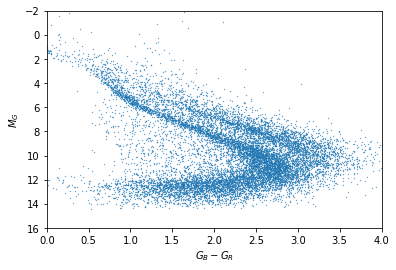

In [3]:
#Absolute magnitude in terms of G and p
Mg_all = [G + 5 - 5*(log10(1000/p)) for G, p in zip(G_all, parallax_all)]
#p is in mas so we divide the listed 1000 by 10

plt.plot(bp_rp_all, Mg_all, '.',markersize = .6)
plt.xlim(0,4)
plt.ylim(16,-2)
plt.xlabel("$G_B - G_R$")
plt.ylabel("$M_G$")
plt.show()

In [4]:
#Get the indices ii of all values for stars that satisfy appropriate photometric conditions
ii = []

for i in range(len(source_id_all)):
    if( (Mg_all[i]<2.46*(bp_rp_all[i])+2.76 and .3<(bp_rp_all[i])<1.8)
       or (Mg_all[i]<2.8*(bp_rp_all[i])+2.16 and 1.8<(bp_rp_all[i]))):
       #or (Mg_all[i]>2.14*(bp_rp_all[i])-.57 and .5<(bp_rp_all[i])<1.2)
       #or (Mg_all[i]>1.11*(bp_rp_all[i])+.66 and 1.2<(bp_rp_all[i])<3)):
        ii.append(i)
        
print(len(ii))

4022


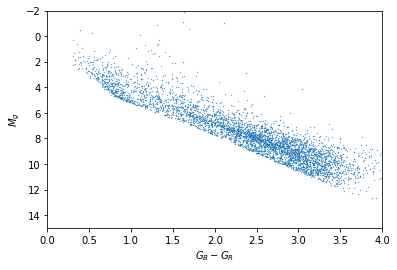

In [5]:
#Redefine our data as all stars that fit photometric parameters of young stars
pmra = pmra_all[ii]
pmdec = pmdec_all[ii]
radial_velocity = radial_velocity_all[ii]
source_id = source_id_all[ii]
ra = ra_all[ii]
dec = dec_all[ii]
parallax = parallax_all[ii]

G = G_all[ii]
Gb = Gb_all[ii]
Gr = Gr_all[ii]

bp_rp = bp_rp_all[ii]

ra_err = ra_err_all[ii]
dec_err = dec_err_all[ii]
pmra_err = pmra_err_all[ii]
pmdec_err = pmdec_err_all[ii]

#############################

Mg = [G + 5 - 5 * log10(1000/p) for G, p in zip(G, parallax)]

plt.plot(bp_rp, Mg, '.',markersize = .6)
plt.xlim(0,4)
plt.ylim(15,-2)
plt.xlabel("$G_B - G_R$")
plt.ylabel("$M_g$")
plt.show()

In [6]:
def toffset(pmra, pmdec, dt):
    return (pmra * dt, pmdec * dt)

def dist(ra, dec):
    return np.array([np.sqrt( (ra[i]-ra)**2 +  (dec[i]-dec)**2 ) for i in range(len(ra))])

arcsec = 1 / 3600
def updated(ra_in, dec_in, pmra_in, pmdec_in, tstep):
    pmraProj, pmdecProj = toffset(pmra_in, pmdec_in, tstep)
    ra_t = ra_in + pmraProj
    dec_t = dec_in + pmdecProj
    
    alldists = dist(ra_t,dec_t)
    
    successfulMatch = np.where((alldists < arcsec) & (alldists != 0.))
    
    return [tstep,successfulMatch[0]]    


In [7]:
"""
allMatches = []
for t in range(-1000000,0,100):
    val = updated(ra, dec, pmra, pmdec, t)
    #print(vals)
    print(val[0], val[1])
    if val[1].size > 0:
        allMatches.append(val)
"""

"""
a = [allMatches[i][0] for i in range(len(allMatches))]
b = table.NdarrayMixin([allMatches[i][1].tolist() for i in range(len(allMatches))])

ta = Table([a, b], names = ('Times', 'Indices'), meta = {'name': 'Time Applied'})
ta.remove_rows(slice(2477,2481))
ta.write('TCoords.ascii', format = 'ascii', overwrite = True)
"""

"""
tab = ascii.read('c:\\users\\sahal\\2018TrinaryWork\\JupyterFiles\\TCoords.ascii')
tab
"""
#After several attempts at trying to save data to files via astropy tables, I've concluded 
#the best way to go is with numpy's .npz

fnam = 'c:\\users\\sahal\\2018trinarywork\\jupyterfiles\\timecoords.npz'
"""
a = np.array([allMatches[i][0] for i in range(len(allMatches))])
b = np.array([allMatches[i][1] for i in range(len(allMatches))])

np.savez(fnam, time = a, ind = b)
"""

inVals = np.load(fnam) #has entries ['time'] and ['ind']
#The current file has a few add|itional time entries in the future that need not exist, running the code again
#will fix this, for now I correct for it manually

In [8]:
tts = inVals['time']
iind = inVals['ind']

tts = np.flip(tts,0)
iind = np.flip(iind,0)


ta = Table([tts, np.array(iind)], names = ('times', 'inds'), meta = {'name': 'IndTable'})
ta.remove_rows(slice(0,4))
tts = ta['times']
iinds = ta['inds']
print(ta)

 times                inds             
------- -------------------------------
      0                       [604 608]
   -100                       [604 608]
   -200                       [604 608]
   -300                       [604 608]
   -400                       [604 608]
   -500           [ 604  608 3965 3966]
   -600           [ 604  608 3965 3966]
   -700           [ 604  608 3965 3966]
   -800           [ 604  608 3965 3966]
   -900 [ 604  608 3173 3201 3965 3966]
    ...                             ...
-978400                     [2911 3281]
-978500                     [2911 3281]
-978600                     [2911 3281]
-978700                     [2911 3281]
-978800                     [2911 3281]
-978900                     [2911 3281]
-983500                     [3383 3568]
-983600                     [3383 3568]
-983700                     [3383 3568]
-983800                     [3383 3568]
-983900                     [3383 3568]
Length = 2477 rows


In [9]:
def getCoords(ra,dec, pmra, pmdec, t):
    if t != 0:
        pmra_atT = pmra * t
        pmdec_atT = pmdec * t
    else:
        pmra_atT = pmra
        pmdec_atT = pmdec
    
    ra_atT = ra + pmra_atT
    dec_atT = dec + pmdec_atT
    return [ra_atT, dec_atT, pmra, pmdec]

In [10]:
def getBox(ras, decs):
    maxDist = np.max([np.max(pmdec),np.max(pmra)]) * 25
    
    xlims = (np.min(ras) -   maxDist, np.max(ras) +  maxDist)
    ylims = (np.min(decs) -  maxDist, np.max(decs) +  maxDist)
    return [xlims, ylims]
    

def makeFig(i):
    currentInd = ta['times'][i]
    #print(currentInd)
    currentT = ta['inds'][i]
    tiCo = getCoords(ra[currentInd], dec[currentInd], pmra[currentInd], pmdec[currentInd], currentT)
    fig, axs = plt.subplots(nrows=1, ncols=1, figsize = (11,11))
    axs.plot(tiCo[0],tiCo[1],'.')
    for jj in range(len(currentInd)):
        x1=tiCo[0][jj]
        y1=tiCo[1][jj]
        xo1=tiCo[2][jj]
        yo1=tiCo[3][jj]
        #axs.arrow(kkra[0][i[0][jj]], kkra[1][i[0]][jj], kkra[2][i[0]][jj], kkra[3][i[0]][jj], width = .0000001)
        #axs.plot(kkra[0][i[0][jj]], kkra[1][i[0]][jj],kkra[0][i[0][jj]]+ 1000* kkra[2][i[0]][jj], kkra[1][i[0]][jj]+1000* kkra[3][i[0]][jj])
        axs.plot([x1, x1+ 100*(xo1)],[y1, y1+100*(yo1)])
    lims = getBox(tiCo[0], tiCo[1])
    
    axs.set_xlim(lims[0])
    axs.set_ylim(lims[1])
    axs.set_title("Time " + str(currentT) +" has " + str(int(len(currentInd)/2)) + " pair(s)")
    return fig

with PdfPages('Plots.pdf') as pdf:
    for i in range(len(ta)):
        ffiigg = makeFig(i)
        pdf.savefig(ffiigg)
    # When no figure is specified the current figure is saved
    pdf.savefig()

In [11]:
def d(ra1, ra2, dec1, dec2):
    return np.sqrt((ra2-ra1)**2 + (dec2 - dec1)**2)

for c in range(len(ta)):
    rowrow = ta['inds'][c]
    ti = ta['times'][c]
    appliedList = getCoords(ra, dec, pmra, pmdec, ti)
    if len(rowrow) > 2:
        print(rowrow)
        raUse = ra[rowrow]
        decUse = dec[rowrow]
        blist = []
        for k in rowrow:
            for j in rowrow:
                #print(d(appliedList[0][k],appliedList[0][j], appliedList[1][k],appliedList[1][j]))
                #if (0 < abs(ra[k] - ra[j]) < arcsec) or (0 < abs(dec[k] - dec[j]) < arcsec):
                if 0 < d(appliedList[0][k],appliedList[0][j], appliedList[1][k],appliedList[1][j]) < arcsec:

                    blist.append([k, j])
        #print(raUse)
        #print(decUse)
        print(blist)
        ta['inds'][c] = blist
        print("============")
    else:
        ta['inds'][c] = [ta['inds'][c]]

[ 604  608 3965 3966]
[[604, 608], [608, 604], [3965, 3966], [3966, 3965]]
[ 604  608 3965 3966]
[[604, 608], [608, 604], [3965, 3966], [3966, 3965]]
[ 604  608 3965 3966]
[[604, 608], [608, 604], [3965, 3966], [3966, 3965]]
[ 604  608 3965 3966]
[[604, 608], [608, 604], [3965, 3966], [3966, 3965]]
[ 604  608 3173 3201 3965 3966]
[[604, 608], [608, 604], [3173, 3201], [3201, 3173], [3965, 3966], [3966, 3965]]
[ 604  608 3965 3966]
[[604, 608], [608, 604], [3965, 3966], [3966, 3965]]
[ 604  608 3965 3966]
[[604, 608], [608, 604], [3965, 3966], [3966, 3965]]
[ 604  608 3965 3966]
[[604, 608], [608, 604], [3965, 3966], [3966, 3965]]
[ 971  972 3965 3966]
[[971, 972], [972, 971], [3965, 3966], [3966, 3965]]
[ 971  972 1015 1017 3965 3966]
[[971, 972], [972, 971], [1015, 1017], [1017, 1015], [3965, 3966], [3966, 3965]]
[ 971  972 1015 1017 3965 3966]
[[971, 972], [972, 971], [1015, 1017], [1017, 1015], [3965, 3966], [3966, 3965]]
[1015 1017 3965 3966]
[[1015, 1017], [1017, 1015], [3965, 396

[228 589 675 677]
[[228, 589], [589, 228], [675, 677], [677, 675]]
[228 589 675 677]
[[228, 589], [589, 228], [675, 677], [677, 675]]
[ 908 1478 2636 2666]
[[908, 1478], [1478, 908], [2636, 2666], [2666, 2636]]
[ 908 1478 2636 2666]
[[908, 1478], [1478, 908], [2636, 2666], [2666, 2636]]
[ 908 1478 2636 2666]
[[908, 1478], [1478, 908], [2636, 2666], [2666, 2636]]
[1256 1370 3424 3485]
[[1256, 1370], [1370, 1256], [3424, 3485], [3485, 3424]]
[ 986 1014 1286 1491]
[[986, 1014], [1014, 986], [1286, 1491], [1491, 1286]]
[1085 1172 1177 1187]
[[1085, 1187], [1172, 1177], [1177, 1172], [1187, 1085]]
[1085 1172 1177 1187]
[[1085, 1187], [1172, 1177], [1177, 1172], [1187, 1085]]
[  83  207 2768 2809]
[[83, 207], [207, 83], [2768, 2809], [2809, 2768]]
[  83  207 2768 2809]
[[83, 207], [207, 83], [2768, 2809], [2809, 2768]]
[  83  207 2768 2809]
[[83, 207], [207, 83], [2768, 2809], [2809, 2768]]
[  83  207 2768 2809]
[[83, 207], [207, 83], [2768, 2809], [2809, 2768]]
[  83  207 2768 2809]
[[83, 2

[ 393  396  435  470 1073 1104]
[[393, 396], [396, 393], [435, 470], [470, 435], [1073, 1104], [1104, 1073]]
[ 393  396  435  470 1073 1104]
[[393, 396], [396, 393], [435, 470], [470, 435], [1073, 1104], [1104, 1073]]
[ 393  396  435  470 1073 1104]
[[393, 396], [396, 393], [435, 470], [470, 435], [1073, 1104], [1104, 1073]]
[ 393  396  435  470 1073 1104]
[[393, 396], [396, 393], [435, 470], [470, 435], [1073, 1104], [1104, 1073]]
[ 393  396  435  470 1073 1104]
[[393, 396], [396, 393], [435, 470], [470, 435], [1073, 1104], [1104, 1073]]
[ 393  396  435  470 1073 1104]
[[393, 396], [396, 393], [435, 470], [470, 435], [1073, 1104], [1104, 1073]]
[ 393  396 1073 1104]
[[393, 396], [396, 393], [1073, 1104], [1104, 1073]]
[ 393  396 1073 1104]
[[393, 396], [396, 393], [1073, 1104], [1104, 1073]]
[ 393  396 1073 1104]
[[393, 396], [396, 393], [1073, 1104], [1104, 1073]]
[ 393  396 1073 1104]
[[393, 396], [396, 393], [1073, 1104], [1104, 1073]]
[ 393  396 1073 1104]
[[393, 396], [396, 393],

[ 374  649 1017 1237]
[[374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 374  649 1017 1237]
[[374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 374  649 1017 1237]
[[374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 202  364  374  649 1017 1237]
[[202, 364], [364, 202], [374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 202  364  374  649 1017 1237]
[[202, 364], [364, 202], [374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 202  364  374  649 1017 1237]
[[202, 364], [364, 202], [374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 202  364  374  649 1017 1237]
[[202, 364], [364, 202], [374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 374  649 1017 1237]
[[374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 374  649 1017 1237]
[[374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 374  649 1017 1237]
[[374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 374  649 1017 1237]
[[374, 649], [649, 374], [1017, 1237], [1237, 1017]]
[ 374  649 1017 1237]
[[374, 649], [649

C:\Python36\.virtualenvs\astropydev\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


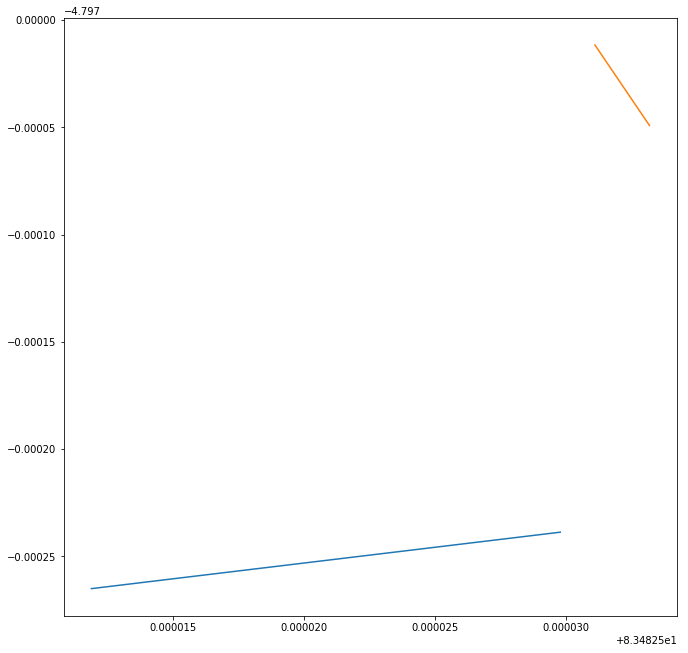

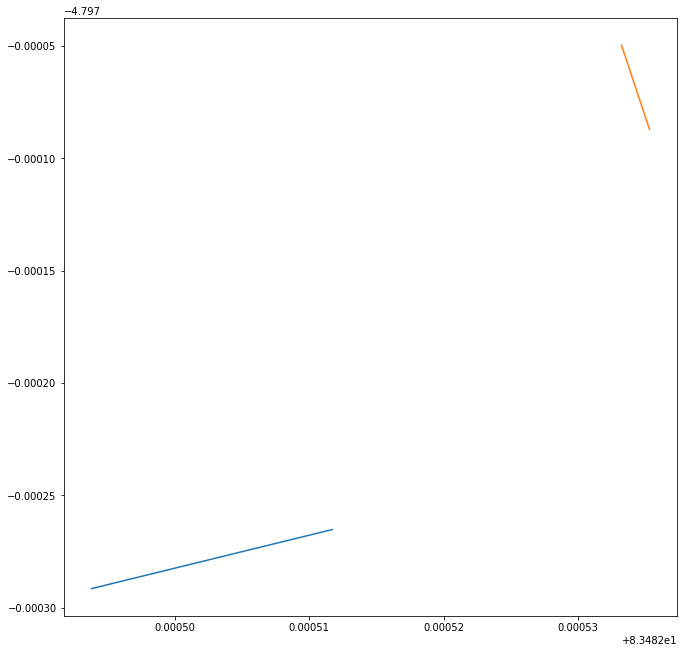

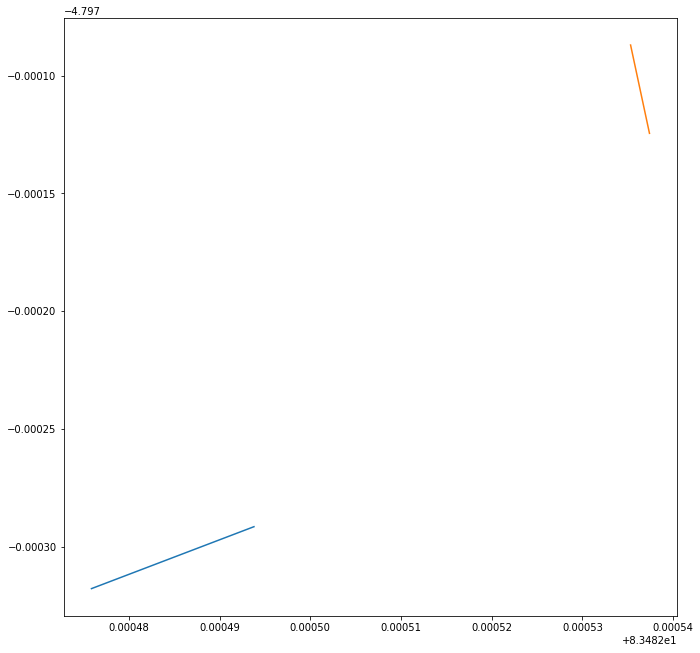

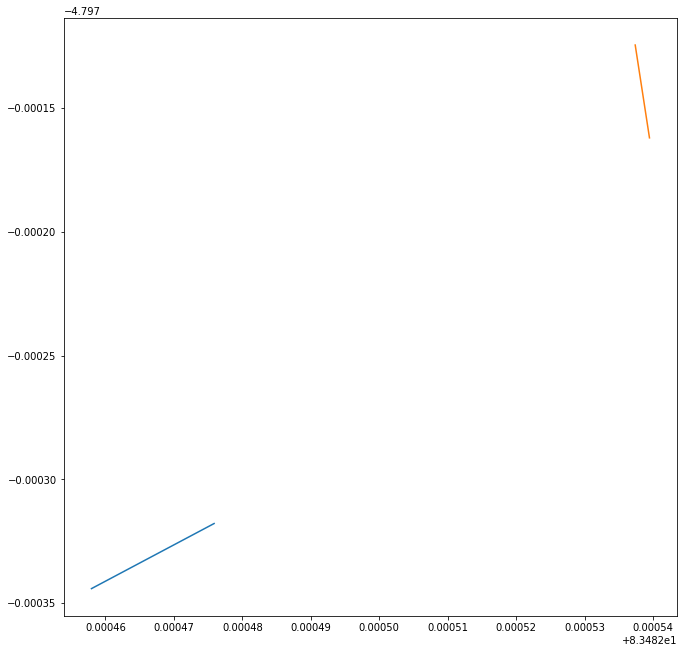

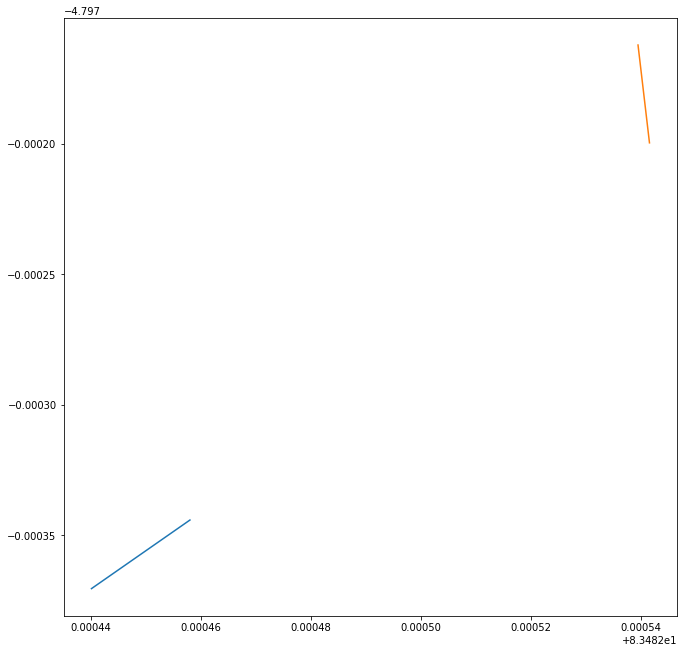

...

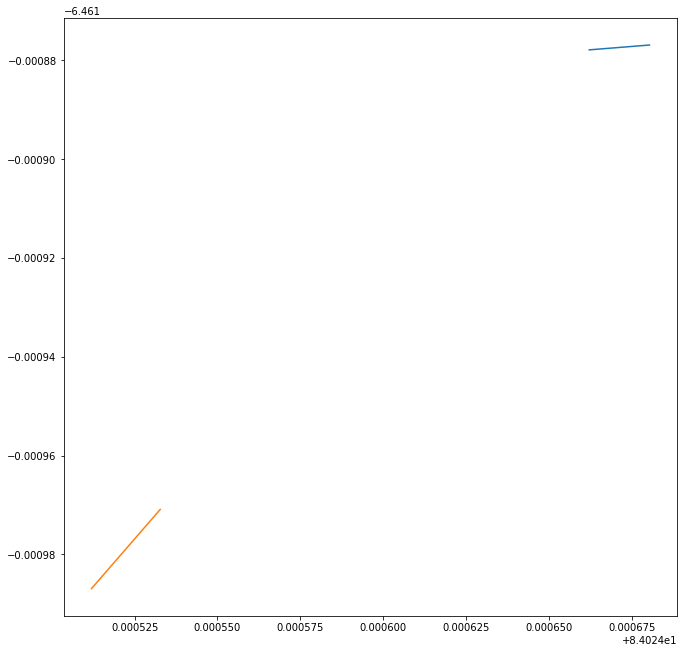

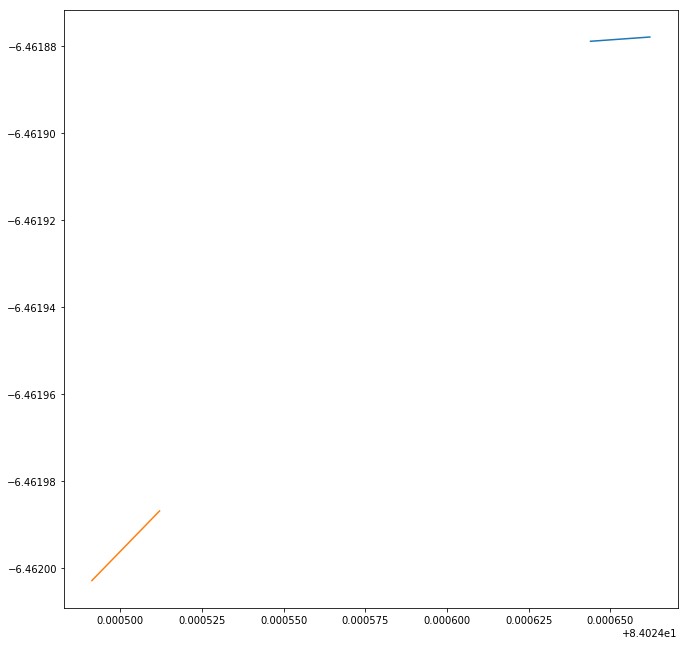

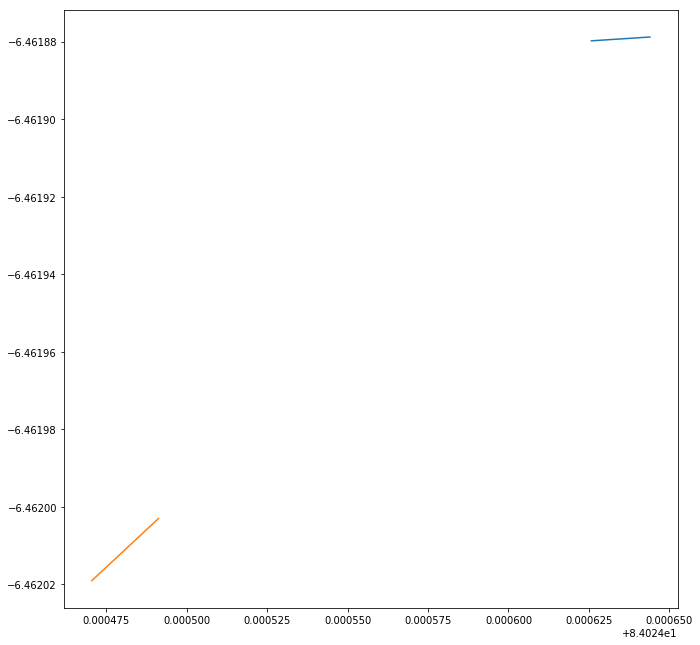

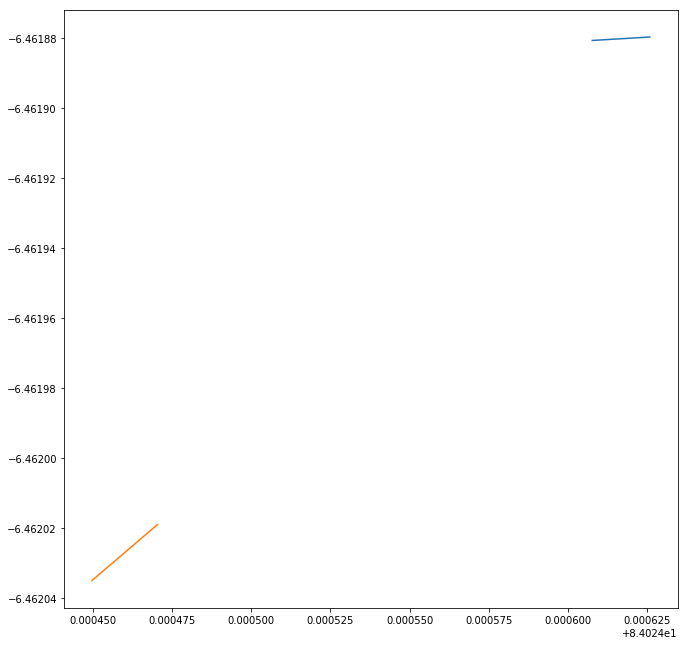

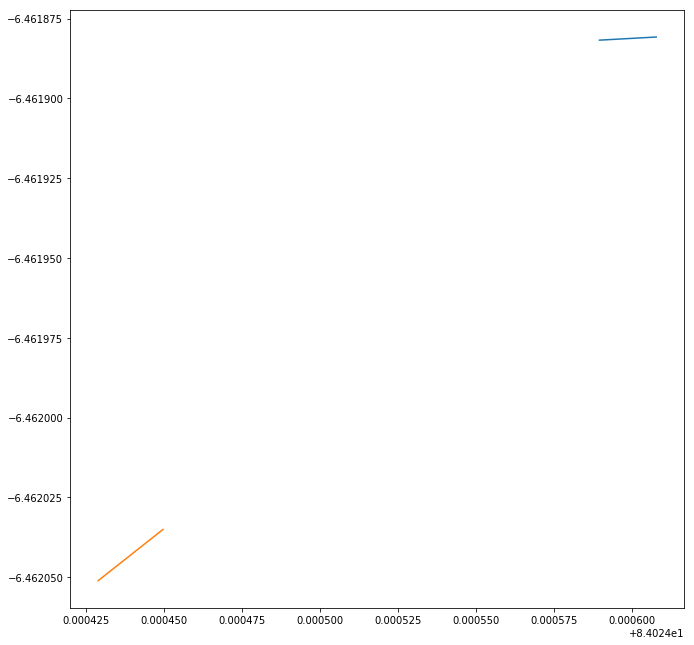

In [12]:
def makeFigNew(i):
    """
    currentInd = ta['inds'][i]
    #print(currentInd)
    currentT = ta['times'][i]
    tiCo = getCoords(ra[currentInd], dec[currentInd], pmra[currentInd], pmdec[currentInd], currentT)
    print(tiCo)
    fig, axs = plt.subplots(nrows=1, ncols=1, figsize = (11,11))
    axs.plot(tiCo[0],tiCo[1],'.')
    for jj in range(len(currentInd)):
        x1=tiCo[0][jj]
        y1=tiCo[1][jj]
        xo1=tiCo[2][jj]
        yo1=tiCo[3][jj]
        #axs.arrow(kkra[0][i[0][jj]], kkra[1][i[0]][jj], kkra[2][i[0]][jj], kkra[3][i[0]][jj], width = .0000001)
        #axs.plot(kkra[0][i[0][jj]], kkra[1][i[0]][jj],kkra[0][i[0][jj]]+ 1000* kkra[2][i[0]][jj], kkra[1][i[0]][jj]+1000* kkra[3][i[0]][jj])
        axs.plot([x1, x1+ 100*(xo1)],[y1, y1+100*(yo1)])
    lims = getBox(tiCo[0], tiCo[1])
    
    axs.set_xlim(lims[0])
    axs.set_ylim(lims[1])
    axs.set_title("Time " + str(currentT) +" has " + str(int(len(currentInd)/2)) + " pair(s)")
    return fig"""
    
    currentInd = ta['inds'][i]
    currentT = ta['times'][i]
    tiCo = getCoords(ra, dec, pmra, pmdec, currentT)
    fig, axs = plt.subplots(nrows=1, ncols=1, figsize = (11,11))

    for pair in currentInd:
        for sp in pair:
            x1 = tiCo[0][sp]
            y1 = tiCo[1][sp]
            xo1 = tiCo[2][sp]
            yo1 = tiCo[3][sp]
            
            axs.plot([x1, x1+100*xo1],[y1,y1+100*yo1])
            
            
        
    
    
with PdfPages('Plots.pdf') as pdf:
    for i in range(len(ta)):
        ffiigg = makeFigNew(i)
        #pdf.savefig(ffiigg)
    # When no figure is specified the current figure is saved
    pdf.savefig()

In [13]:
print(ta['inds'][38])

[[197, 198], [198, 197], [2418, 2419], [2419, 2418]]


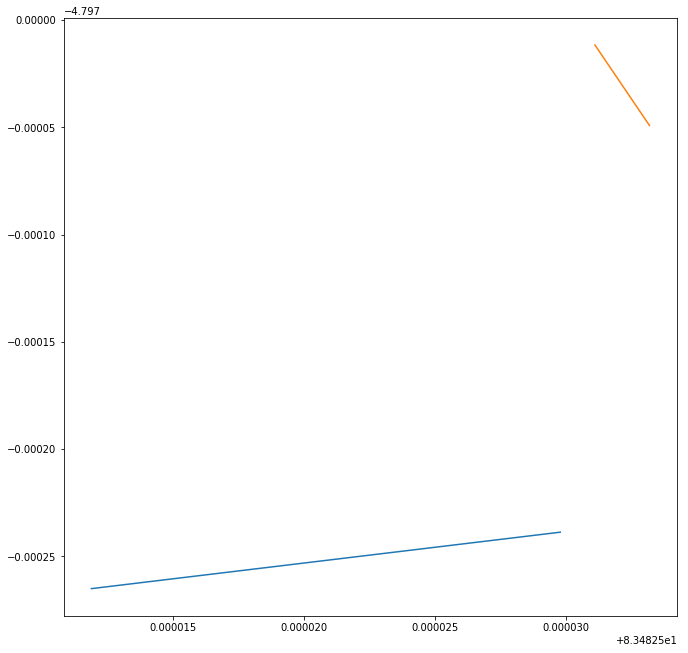

In [14]:
makeFigNew(0)